In [1]:
import numpy as np
import pandas as pd
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LinearRegression,Lasso,Ridge,ElasticNet,LassoCV,RidgeCV,ElasticNetCV,LogisticRegression
from sklearn.metrics import confusion_matrix,roc_curve,roc_auc_score
from sklearn.model_selection import train_test_split
from statsmodels.stats.outliers_influence import variance_inflation_factor
from pandas_profiling import ProfileReport
import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib
import pickle
%matplotlib inline

In [2]:
df = pd.read_csv("https://raw.githubusercontent.com/plotly/datasets/master/diabetes.csv")

In [3]:
df.head()

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age,Outcome
0,6,148,72,35,0,33.6,0.627,50,1
1,1,85,66,29,0,26.6,0.351,31,0
2,8,183,64,0,0,23.3,0.672,32,1
3,1,89,66,23,94,28.1,0.167,21,0
4,0,137,40,35,168,43.1,2.288,33,1


In [4]:
df.shape

(768, 9)

In [5]:
df.isnull().sum()

Pregnancies                 0
Glucose                     0
BloodPressure               0
SkinThickness               0
Insulin                     0
BMI                         0
DiabetesPedigreeFunction    0
Age                         0
Outcome                     0
dtype: int64

In [14]:
#Using Profile will work here
ProfileReport(df)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [8]:
df.describe()

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age,Outcome
count,768.000000,768.000000,768.000000,768.000000,768.000000,768.000000,768.000000,768.000000,768.000000
mean,3.845052,120.894531,69.105469,20.536458,79.799479,31.992578,0.471876,33.240885,0.348958
std,3.369578,31.972618,19.355807,15.952218,115.244002,7.884160,0.331329,11.760232,0.476951
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.078000,21.000000,0.000000
25%,1.000000,99.000000,62.000000,0.000000,0.000000,27.300000,0.243750,24.000000,0.000000
50%,3.000000,117.000000,72.000000,23.000000,30.500000,32.000000,0.372500,29.000000,0.000000
75%,6.000000,140.250000,80.000000,32.000000,127.250000,36.600000,0.626250,41.000000,1.000000
max,17.000000,199.000000,122.000000,99.000000,846.000000,67.100000,2.420000,81.000000,1.000000


In [15]:
df.head()

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age,Outcome
0,6,148,72,35,0,33.6,0.627,50,1
1,1,85,66,29,0,26.6,0.351,31,0
2,8,183,64,0,0,23.3,0.672,32,1
3,1,89,66,23,94,28.1,0.167,21,0
4,0,137,40,35,168,43.1,2.288,33,1


- Due to presence of number of Zeros in Data -> Replace them with mean of value

In [22]:
df.BMI = df.BMI.replace(0,df.BMI.mean())
df.Glucose = df.Glucose.replace(0,df.Glucose.mean())
df.BloodPressure = df.BloodPressure.replace(0,df.BloodPressure.mean())
df.SkinThickness = df.SkinThickness.replace(0,df.SkinThickness.mean())
df.Insulin = df.Insulin.replace(0,df.Insulin.mean())

In [23]:
ProfileReport(df)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

- Detecting Outliers

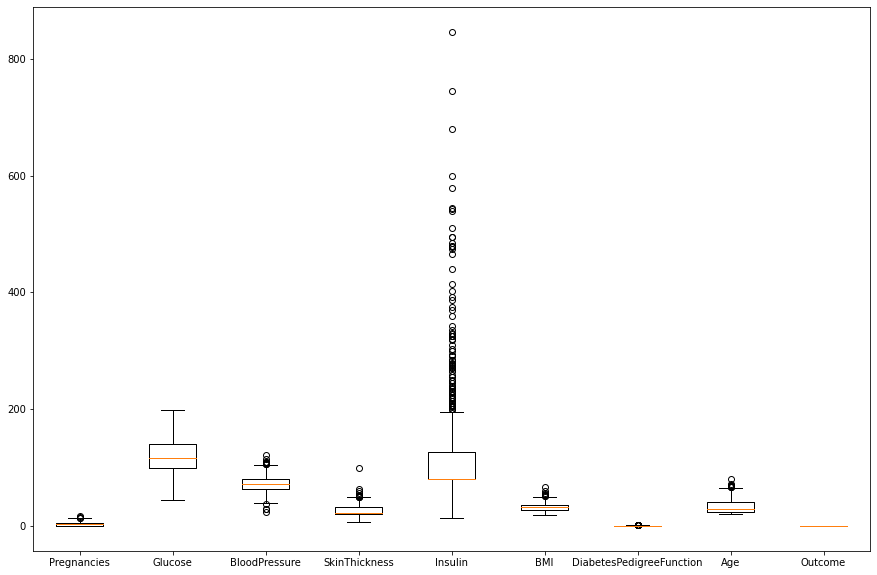

In [34]:
plt.figure(figsize=(15,10))
plt.boxplot(df,labels=['Pregnancies', 'Glucose', 'BloodPressure', 'SkinThickness', 'Insulin',
       'BMI', 'DiabetesPedigreeFunction', 'Age', 'Outcome']);

- observation Various outliers in this data

In [29]:
df.columns

Index(['Pregnancies', 'Glucose', 'BloodPressure', 'SkinThickness', 'Insulin',
       'BMI', 'DiabetesPedigreeFunction', 'Age', 'Outcome'],
      dtype='object')

In [35]:
q = df.Insulin.quantile(0.95)
new_df = df[df.Insulin<q]

In [39]:
new_df

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age,Outcome
0,6,148.0,72.0,35.000000,79.799479,33.6,0.627,50,1
1,1,85.0,66.0,29.000000,79.799479,26.6,0.351,31,0
2,8,183.0,64.0,20.536458,79.799479,23.3,0.672,32,1
3,1,89.0,66.0,23.000000,94.000000,28.1,0.167,21,0
4,0,137.0,40.0,35.000000,168.000000,43.1,2.288,33,1
...,...,...,...,...,...,...,...,...,...
763,10,101.0,76.0,48.000000,180.000000,32.9,0.171,63,0
764,2,122.0,70.0,27.000000,79.799479,36.8,0.340,27,0
765,5,121.0,72.0,23.000000,112.000000,26.2,0.245,30,0
766,1,126.0,60.0,20.536458,79.799479,30.1,0.349,47,1


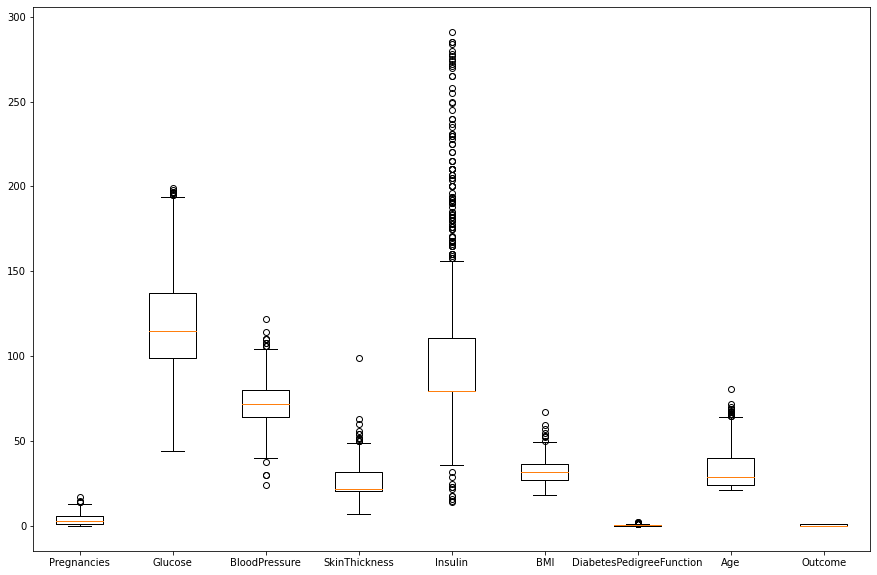

In [38]:
plt.figure(figsize=(15,10))
plt.boxplot(new_df,labels=['Pregnancies', 'Glucose', 'BloodPressure', 'SkinThickness', 'Insulin',
       'BMI', 'DiabetesPedigreeFunction', 'Age', 'Outcome']);

In [41]:
feature = ['Pregnancies', 'Glucose', 'BloodPressure', 'SkinThickness', 'Insulin',
       'BMI', 'DiabetesPedigreeFunction', 'Age']
for i in feature:
    q = new_df[i].quantile(0.98)
    new_df = new_df[new_df[i]<q]
new_df

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age,Outcome
0,6,148.0,72.0,35.000000,79.799479,33.6,0.627,50,1
1,1,85.0,66.0,29.000000,79.799479,26.6,0.351,31,0
2,8,183.0,64.0,20.536458,79.799479,23.3,0.672,32,1
3,1,89.0,66.0,23.000000,94.000000,28.1,0.167,21,0
5,5,116.0,74.0,20.536458,79.799479,25.6,0.201,30,0
...,...,...,...,...,...,...,...,...,...
762,9,89.0,62.0,20.536458,79.799479,22.5,0.142,33,0
764,2,122.0,70.0,27.000000,79.799479,36.8,0.340,27,0
765,5,121.0,72.0,23.000000,112.000000,26.2,0.245,30,0
766,1,126.0,60.0,20.536458,79.799479,30.1,0.349,47,1


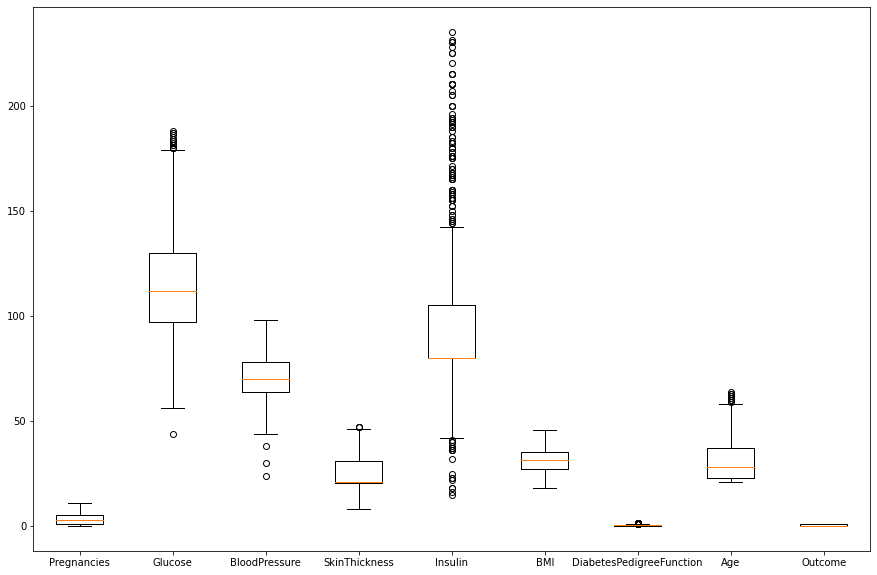

In [43]:
plt.figure(figsize=(15,10))
plt.boxplot(new_df,labels=['Pregnancies', 'Glucose', 'BloodPressure', 'SkinThickness', 'Insulin',
       'BMI', 'DiabetesPedigreeFunction', 'Age', 'Outcome']);

In [45]:
ProfileReport(new_df)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

- StanderdSclaing of Data

In [46]:
standscal = StandardScaler()

In [47]:
y = new_df.Outcome
X = new_df.drop('Outcome',axis=1)

In [48]:
X=standscal.fit_transform(X)

In [53]:
name = ['Pregnancies', 'Glucose', 'BloodPressure', 'SkinThickness', 'Insulin',
       'BMI', 'DiabetesPedigreeFunction', 'Age']

In [58]:
pd.DataFrame([name,[variance_inflation_factor(X,i) for i in range(X.shape[1])]])

,0,1,2,3,4,5,6,7
0,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age
1,1.470069,1.271726,1.205665,1.411715,1.261599,1.432364,1.043036,1.642073


- No Feature Show any VIF more then 10 so we can work with it

- Spliting test and train data

In [59]:
X_train,X_test,y_train,y_test = train_test_split(X,y,test_size=0.15,random_state=10)

- Implementing Logestic Regression

In [60]:
lg_liblinear = LogisticRegression(solver='liblinear')
lg_default = LogisticRegression()

In [61]:
lg_liblinear.fit(X_train,y_train)
lg_default.fit(X_train,y_train)

LogisticRegression()

In [62]:
## Score for Lg_liblinear model
lg_liblinear.score(X_test,y_test)

0.8043478260869565

In [63]:
## Score for Lg_default
lg_default.score(X_test,y_test)

0.8043478260869565

- For Better Understanding Implementing Confusion Matrix

In [66]:
## Lg_liblinear model
confusion_matrix(lg_liblinear.predict(X_test),y_test).ravel()

array([59,  8, 10, 15], dtype=int64)

In [65]:
confusion_matrix(lg_default.predict(X_test),y_test)

array([[59,  8],
       [10, 15]], dtype=int64)

In [72]:
# Creating a function to Pridect model All Evaluation:
def model_eval(y_ans,y_pred):
    """Need 2 inputs : True Value of Y, Predict Value of Y"""
    tn,fp,fn,tp = confusion_matrix(y_ans,y_pred).ravel()
    accuracy = (tp+tn)/(tp+tn+fp+fn)
    recall = tp/(tp+fn)
    precision = tp/(tp+fp)
    specificity = tn/(fp+tn)
    F1_score = (2*recall*precision)/(recall+precision)
    return {"Accuracy" : accuracy, "Recall" : recall, "Precision" : precision, "Specificity" : specificity, "F1_score" : F1_score}

In [73]:
#model Evalution:
model_eval(y_test,lg_default.predict(X_test))

{'Accuracy': 0.8043478260869565,
 'Recall': 0.6521739130434783,
 'Precision': 0.6,
 'Specificity': 0.855072463768116,
 'F1_score': 0.6250000000000001}

- Using ROC Curve

In [74]:
y_pred = lg_default.predict(X_test)

In [80]:
#Roc Area
auc = roc_auc_score(y_test,y_pred)

In [81]:
#Using ROC Curve and Plot it
roc_curve(y_test,y_pred)

(array([0.        , 0.14492754, 1.        ]),
 array([0.        , 0.65217391, 1.        ]),
 array([2, 1, 0], dtype=int64))

In [82]:
fpr, tpr, thresholds = roc_curve(y_test,y_pred)

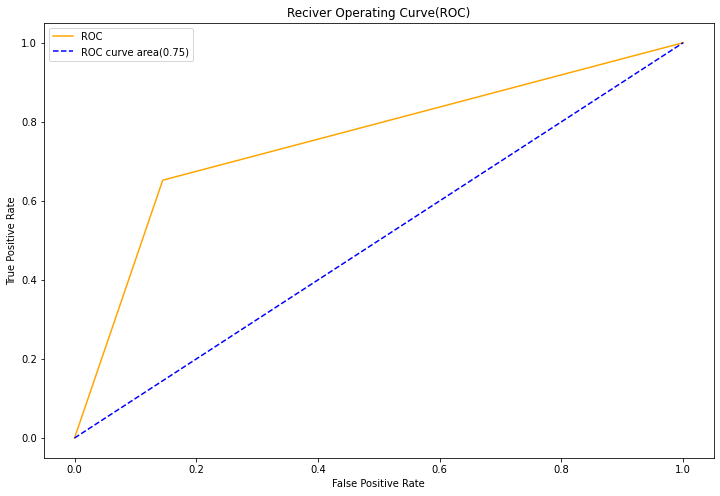

In [83]:
#ploting Values:
plt.figure(figsize=(12,8))
plt.plot(fpr,tpr,color='orange',label="ROC")
plt.plot([0,1],[0,1],color='blue',linestyle='--',label="ROC curve area(%0.2f)"%auc)
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.title("Reciver Operating Curve(ROC)")
plt.legend()